In [34]:
%load_ext autoreload
%autoreload 2

import sys
sys.path.append("../../../src/")

import os
import pandas as pd
import numpy as np
import random
from eda.utils_plot import get_upack_patch, save2pdf, visualize_col_data
from eda.general_eda import general_stats, general_eda_main

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Stats computation & analysis of AI4boundaries dataset

For each country:

1. Download image mask.
2. compute patch stats.
3. compute general stats.
4. visualize random problematic patches (e. g. no fields, small number of fields, small percentage of fields, complex fields, ...).
5. final analysis for country.

Comparison analysis between countries. Localization. Number of parcels, area covered with fields, parcels sizes, parcels geometry, ...
Final analysis.

In [2]:
SENTINEL2_DIR = "ai4boundaries_dataset"

### Netherlands (NL)

In [3]:
country = "NL"

In [ ]:
# download data (masks, images)
!python "../../src/eda/download_masks.py" --country="NL" --sentinel_dir=SENTINEL2_DIR

In [ ]:
# compute stats for every pair of masks, images
!python "../../src/eda/patch_stats_computation.py" --country="NL" --sentinel_dir=SENTINEL2_DIR

#### General EDA for the country

General information: 
           n_fields   prc_fields  sm_area_cnt  bg_area_cnt  sm_solidity_cnt  \
count  1157.000000  1157.000000  1157.000000  1157.000000      1157.000000   
mean    147.764909    44.638375    23.475367     0.165946         1.707001   
std     108.601769    28.387909    25.832046     0.653801         6.722996   
min       0.000000     0.000000     0.000000     0.000000         0.000000   
25%      58.000000    17.300000     8.000000     0.000000         0.000000   
50%     134.000000    47.900000    19.000000     0.000000         0.000000   
75%     219.000000    70.000000    31.000000     0.000000         2.000000   
max     682.000000    94.500000   346.000000     9.000000       154.000000   

       bg_solidity_cnt  sm_eccentricity_cnt      area_min     area_mean  \
count      1157.000000          1157.000000   1094.000000   1094.000000   
mean         94.576491             1.454624     17.233090    277.309905   
std          67.202918             2.211731    35

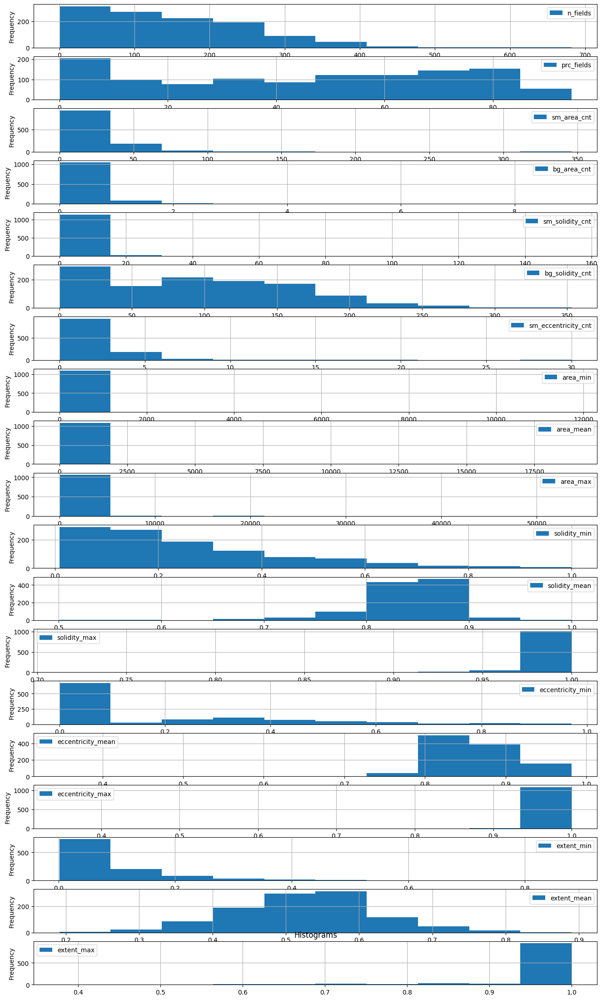

Total number of fields 0.17 M
Total area of fields in ha 33.85 M
Number of patches without fields present 63 (5.45%)
Number of patches with small percentage  (< 10) of fields present 143 (12.36%)
Number of patches with small number (< 40) of fields present 169 (14.61%)
Number of patches with small number or small percentage of fields present combined 186 (16.08%)
Number of patches with small number & small percentage of fields present combined 126 (10.89%)
Number of patches with n_fields (>= 364.97) of fields present 41 (3.54%)
Number of patches with prc_fields (>= 75.0) of fields present 214 (18.5%)
Number of patches with prc_fields (< 25.0) of fields present 344 (29.73%)
Number of patches with sm_area_cnt (>= 75.14) of fields present 32 (2.77%)
Number of patches with bg_area_cnt (>= 1.47) of fields present 36 (3.11%)
Number of patches with sm_solidity_cnt (>= 15.15) of fields present 16 (1.38%)
Number of patches with bg_solidity_cnt (>= 228.98) of fields present 32 (2.77%)
Number of 

In [36]:
#!python "../../src/eda/general_eda.py" --country="NL" --sentinel_dir=SENTINEL2_DIR
data = general_eda_main(SENTINEL2_DIR, country,
                     sm_prc_fields=10, sm_num_fields=40)

### Visualizations of the country data

In [ ]:
# visualize the data with small number of fields (<40)
visualize_col_data(data, SENTINEL2_DIR, country='NL', col='sm_num_fields', num_img=2,
                       num_plots=5) # isolated fields in the city, forest, ...

In [ ]:
# visualize the data with number of fields > 364 in the image
visualize_col_data(data, SENTINEL2_DIR, country='NL', col='n_fields_gt', num_img=2,
                       num_plots=5) # no interest -> vis similar to 'prc_fields_gt'

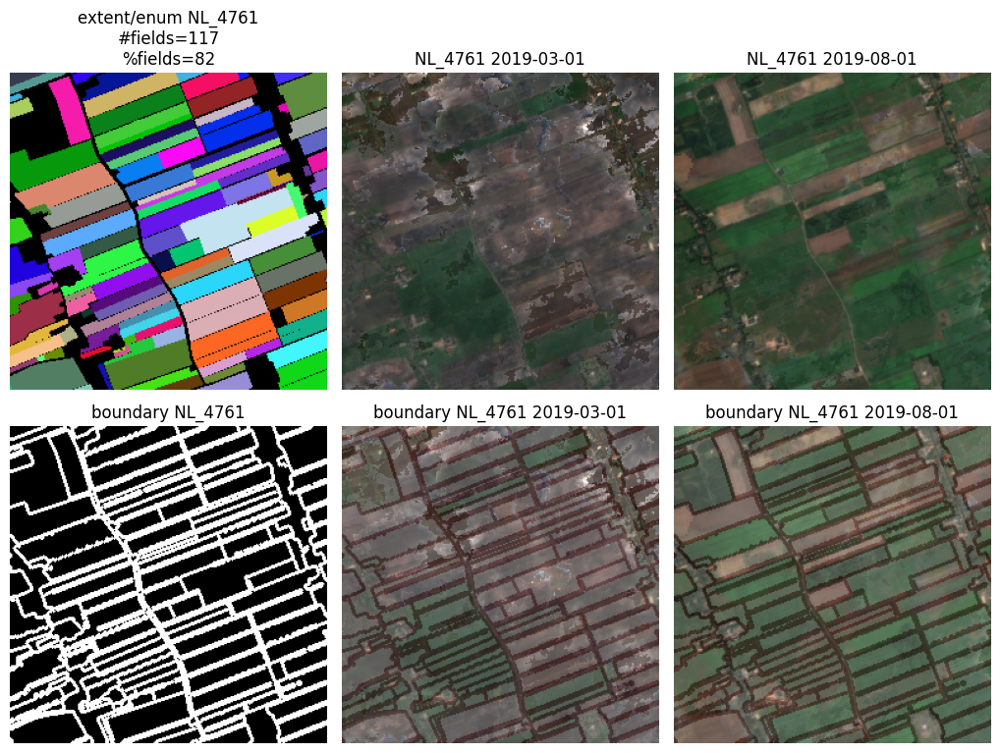

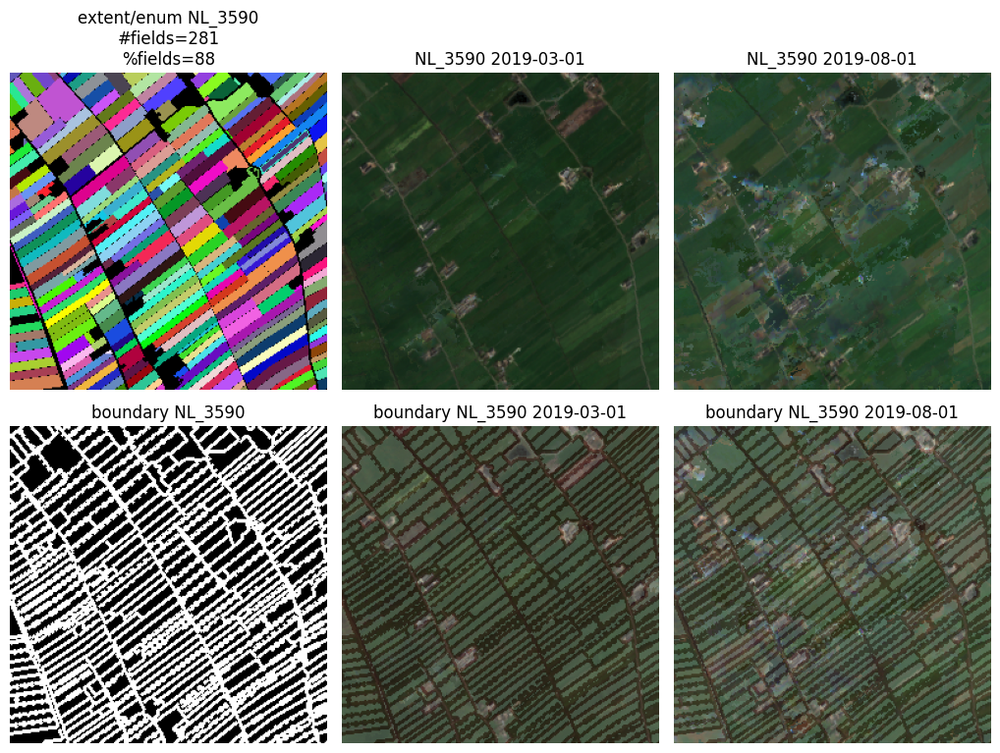

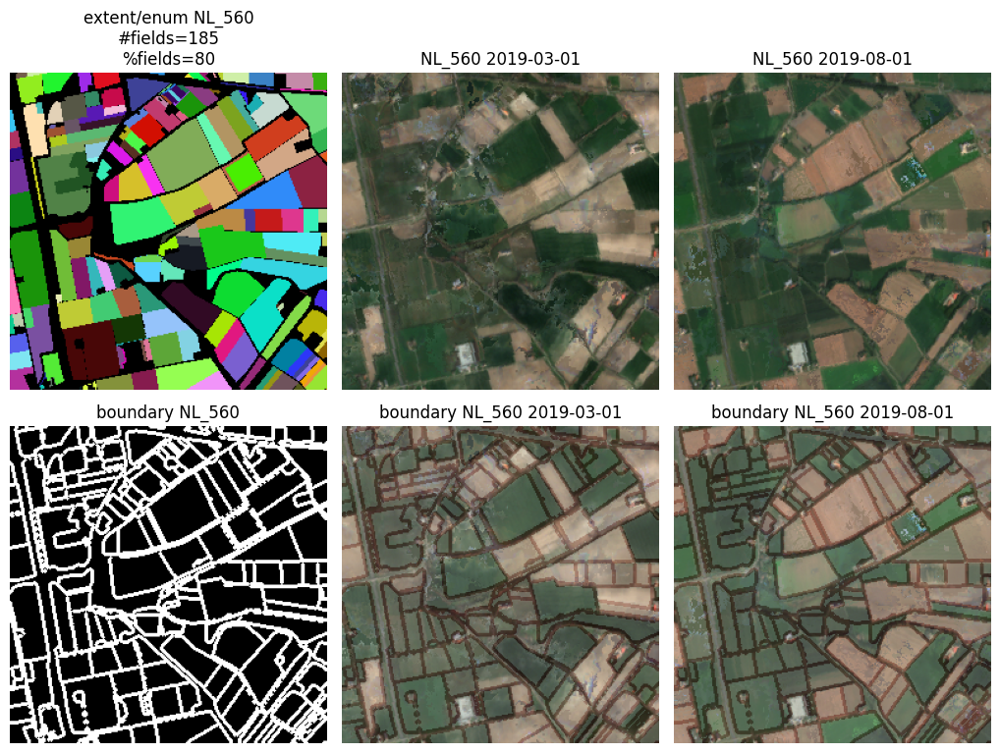

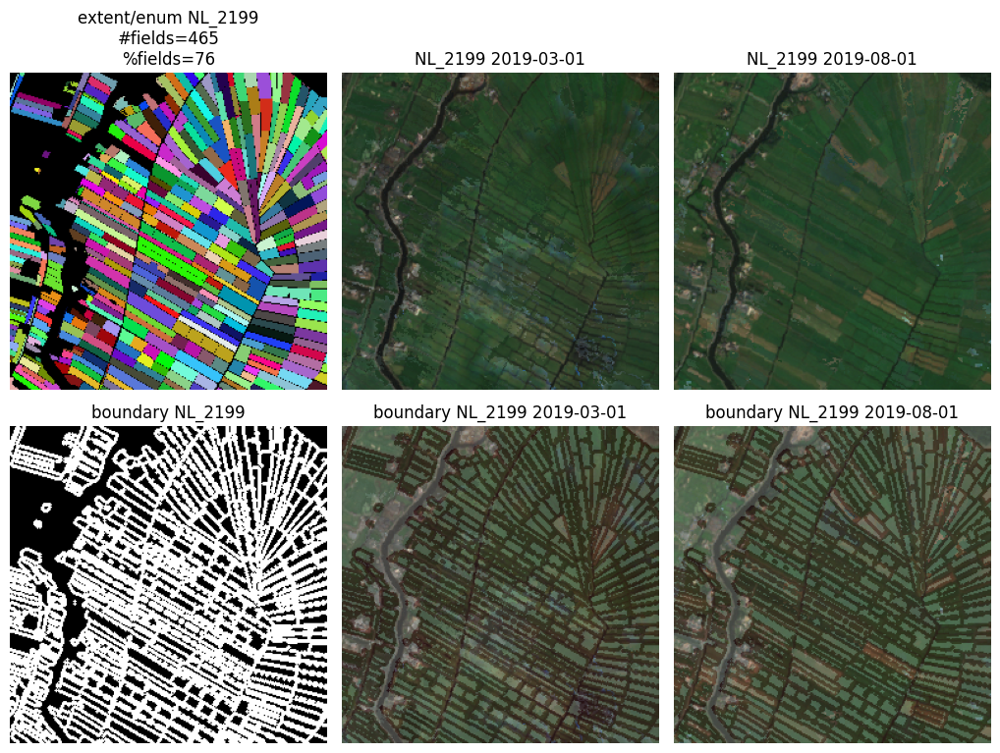

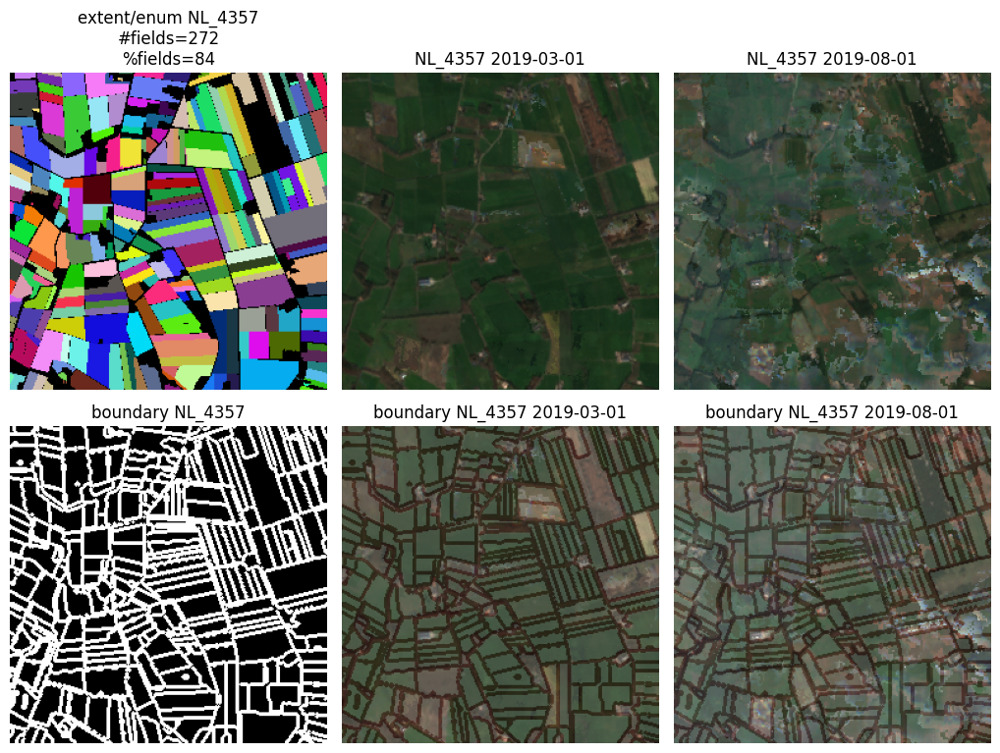

In [39]:
# visualize the data with % of fields > 75% in the image
visualize_col_data(data, SENTINEL2_DIR, country='NL', col='prc_fields_gt', num_img=2,
                       num_plots=5)

In [ ]:
# visualize the data with no fields in the image
visualize_col_data(data, SENTINEL2_DIR, country='NL', col='no_field', num_img=2,
                       num_plots=2) # city scenes, forest, ...,

In [ ]:
# visualize the data with number of small by area fields > 75 in the image
visualize_col_data(data, SENTINEL2_DIR, country='NL', col='sm_area_cnt_gt', num_img=2,
                       num_plots=2) # no much diff from visualization 'prc_fields_gt' or 'n_fields_gt' -> a lot of rect alongated parcels with varied width

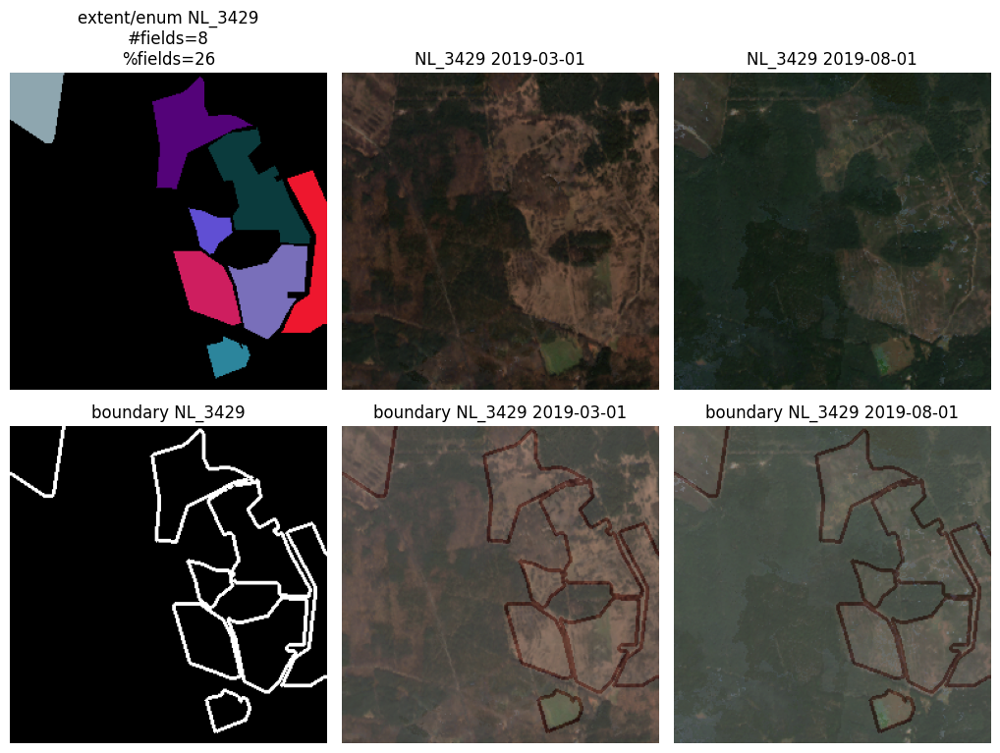

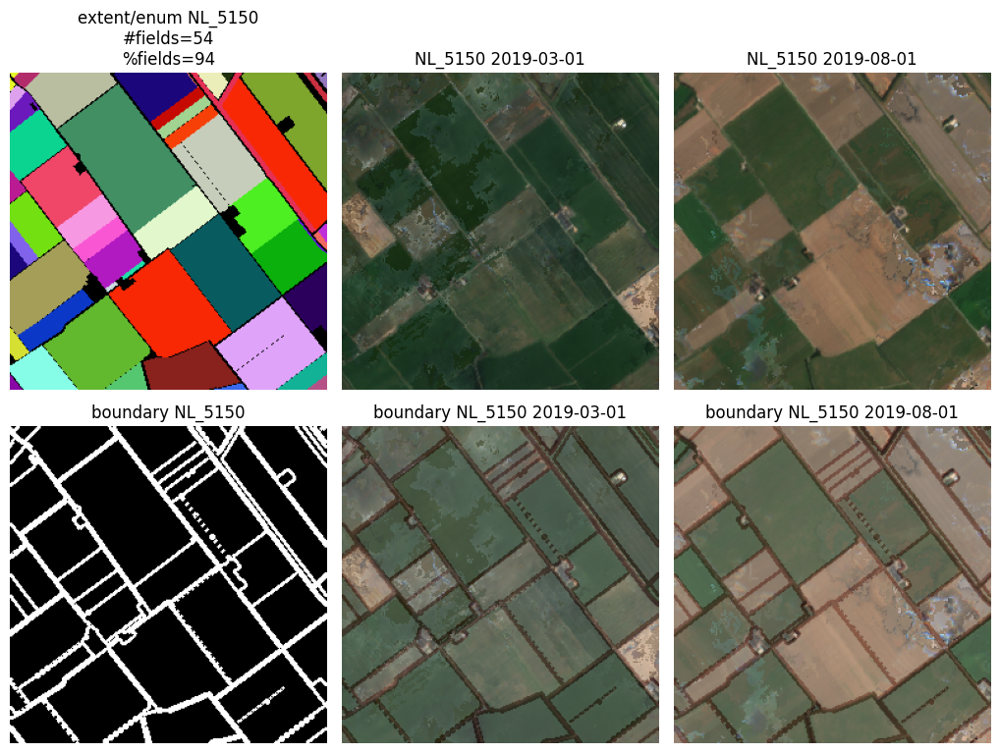

In [57]:
# visualize the data with number of big by area fields > 1 in the image
visualize_col_data(data, SENTINEL2_DIR, country='NL', col='bg_area_cnt_gt', num_img=2,
                       num_plots=2)

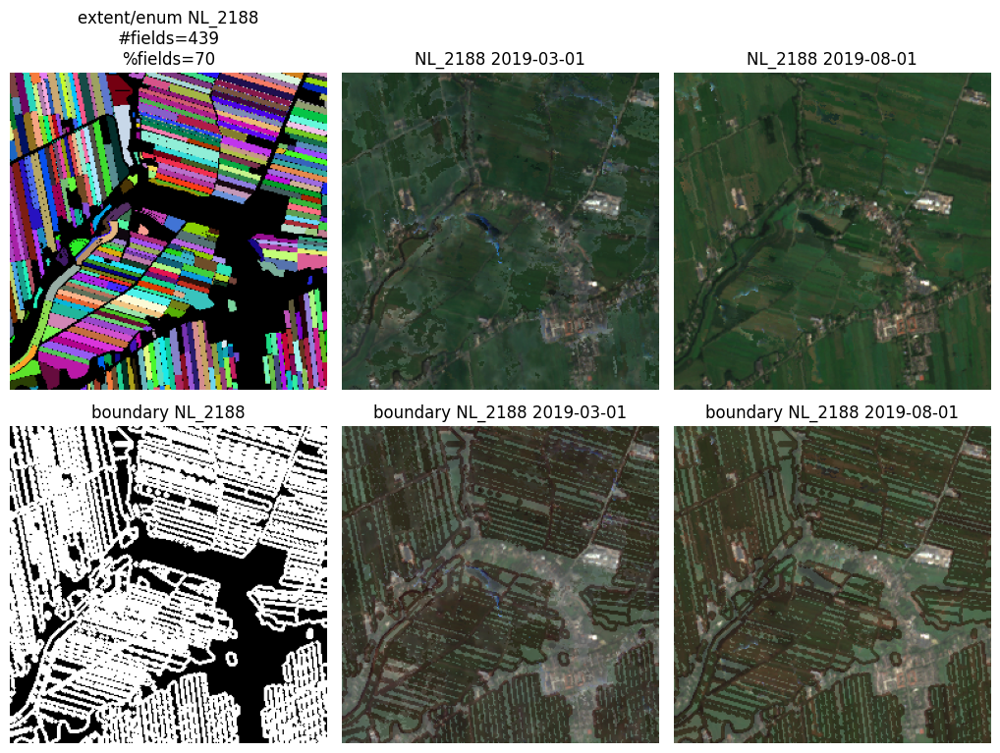

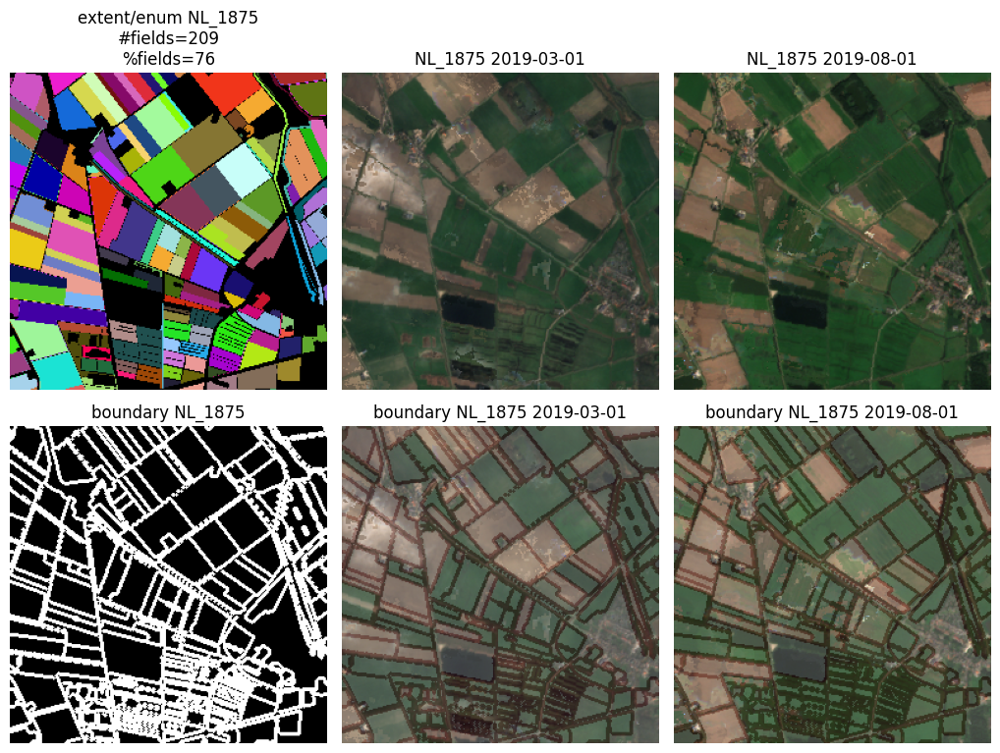

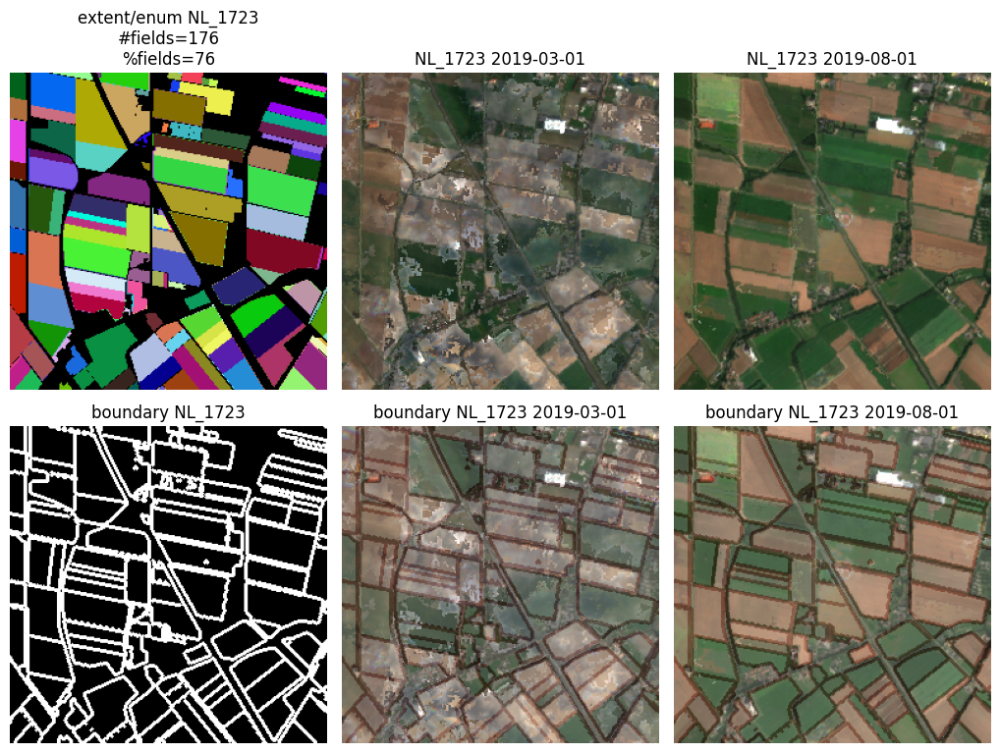

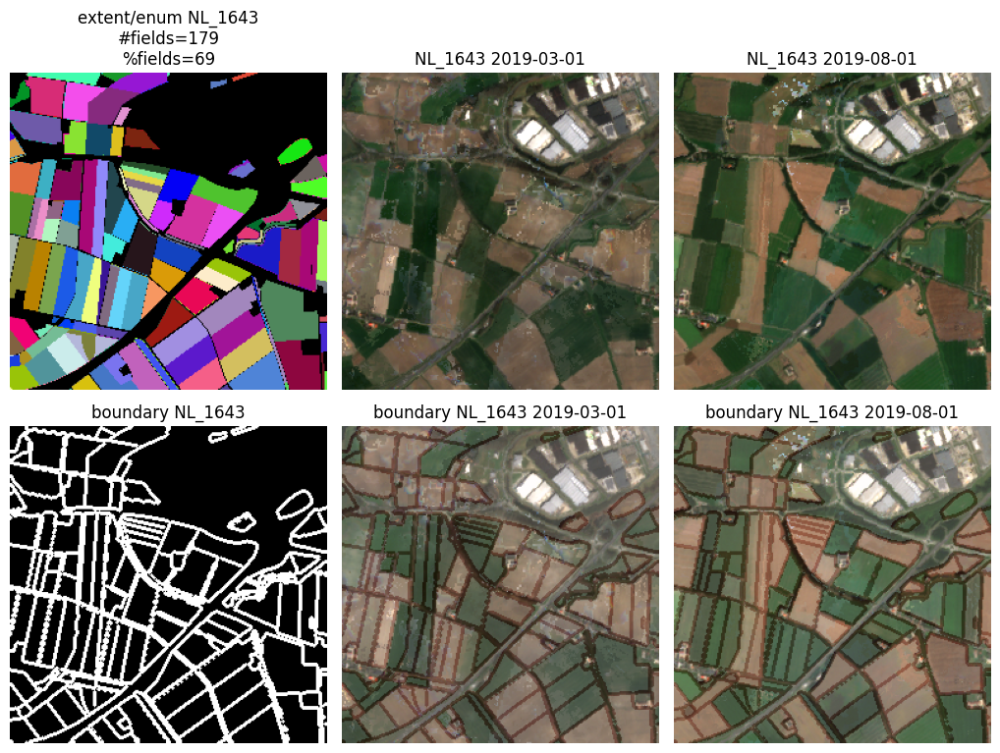

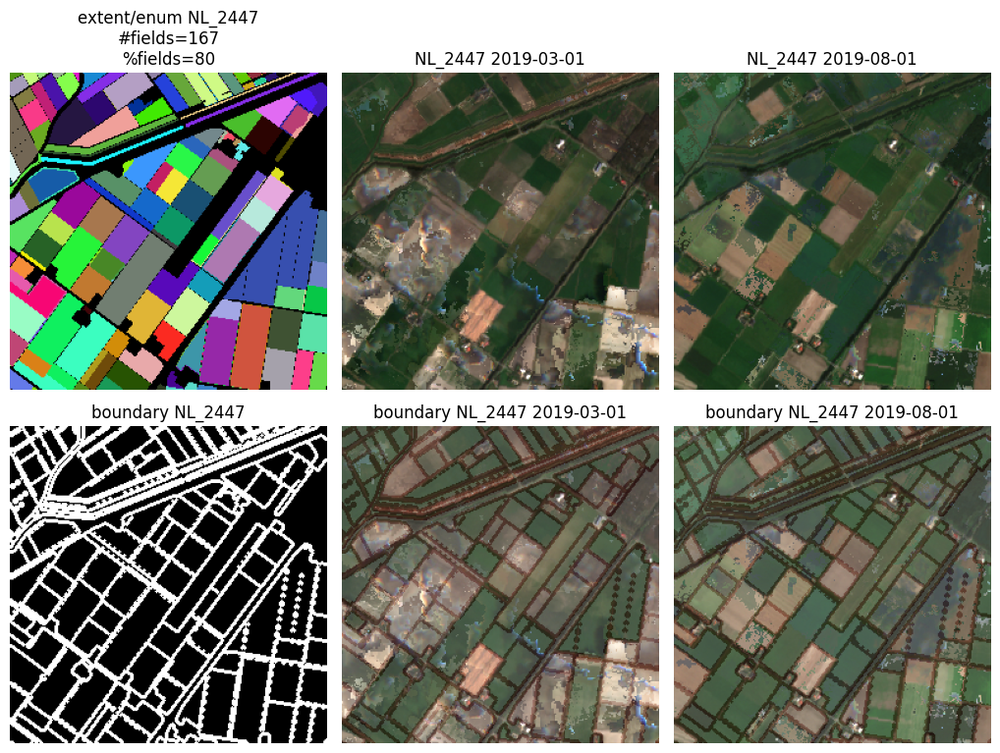

In [50]:
# visualize the data with number of small solifity count of fields > 15 in the image
# Number of patches with sm_solidity_cnt (>= 15.15) of fields present 16 (1.38%)
visualize_col_data(data, SENTINEL2_DIR, country='NL', col='sm_solidity_cnt_gt', num_img=2,
                       num_plots=5)

In [ ]:
# visualize the data with number of big solifity count of fields > 228 in the image
# Number of patches with bg_solidity_cnt (>= 228.98) of fields present 32 (2.77%)
visualize_col_data(data, SENTINEL2_DIR, country='NL', col='bg_solidity_cnt_gt', num_img=2,
                       num_plots=3) # no much diff from visualization 'prc_fields_gt' or 'n_fields_gt' -> a lot of rect alongated parcels with varied width

In [ ]:
# visualize the data with number of small eccentricity count of fields > 5 in the image
# Number of patches with sm_eccentricity_cnt (>= 5.88) of fields present 46 (3.98%)
visualize_col_data(data, SENTINEL2_DIR, country='NL', col='sm_eccentricity_cnt_gt', num_img=2,
                       num_plots=2) # no much diff from visualization 'prc_fields_gt' or 'n_fields_gt' -> a lot of rect alongated parcels with varied width

### Conclusion for the country (NL)

Present very small alongated fields as in Poland:

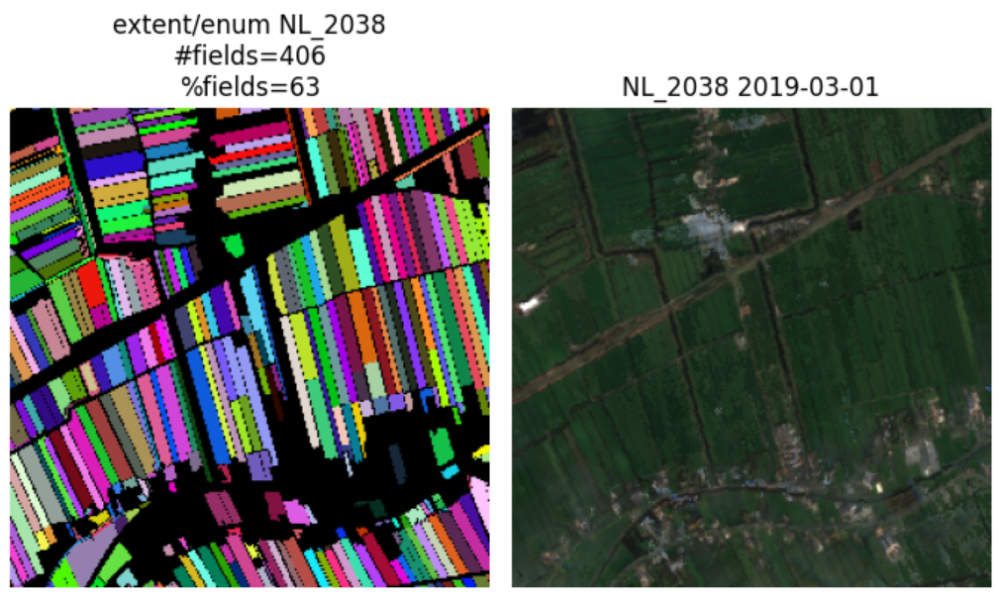

Not during all of the months fields are visible (something is planted):

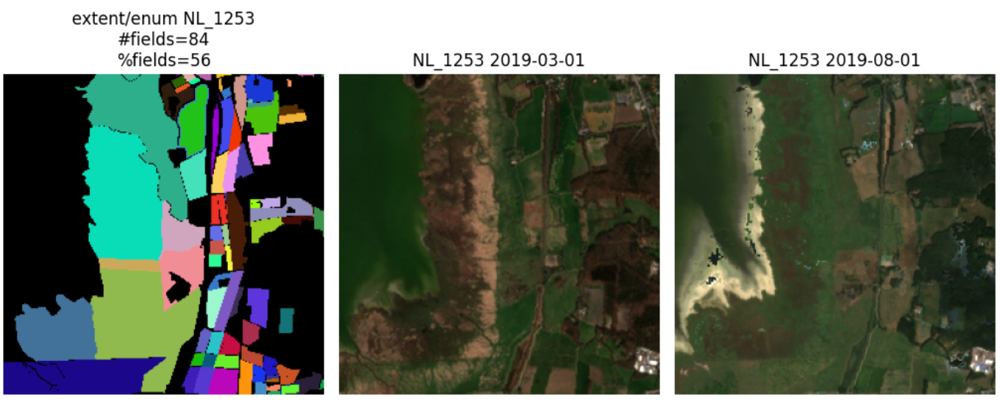

No field data (possibilty of missing gt data or forest area image / town) -> better delete from training dataset

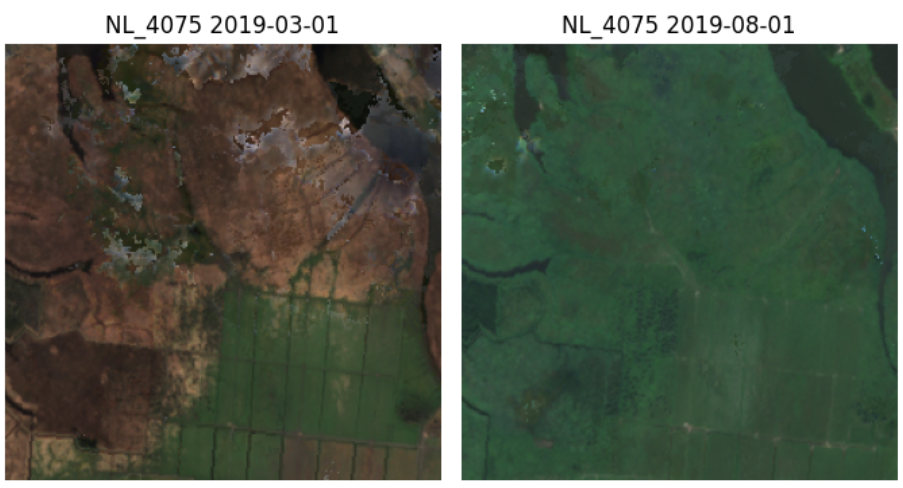

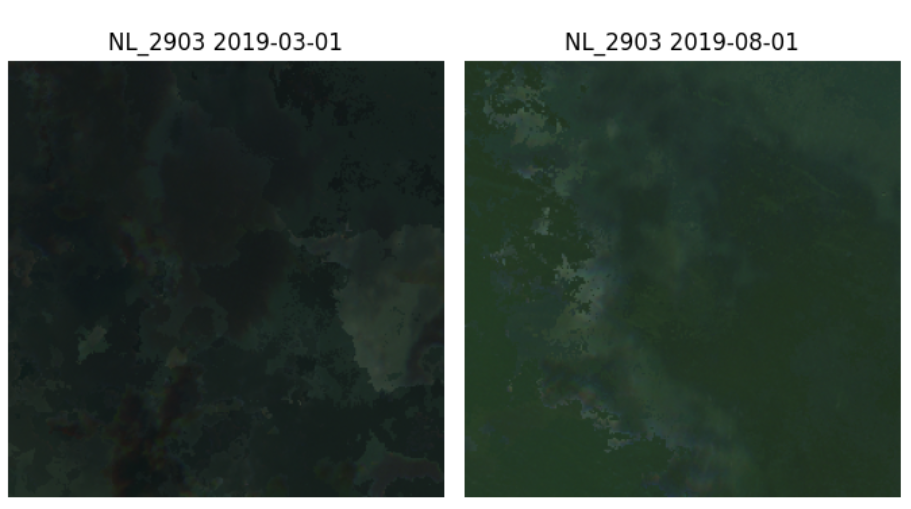

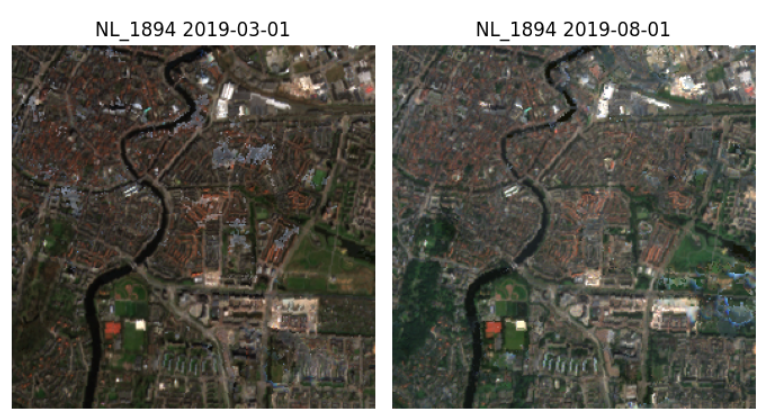

Strange shape in image for the field (very radged - not even border):
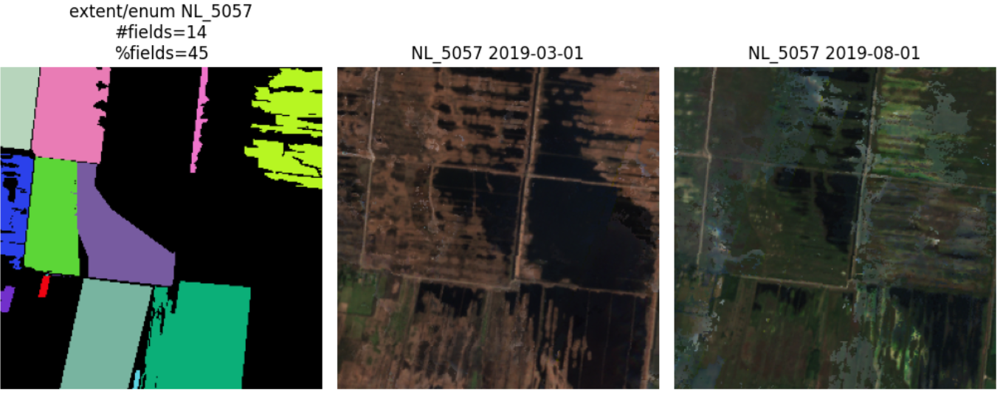

Isolated in the city fields:

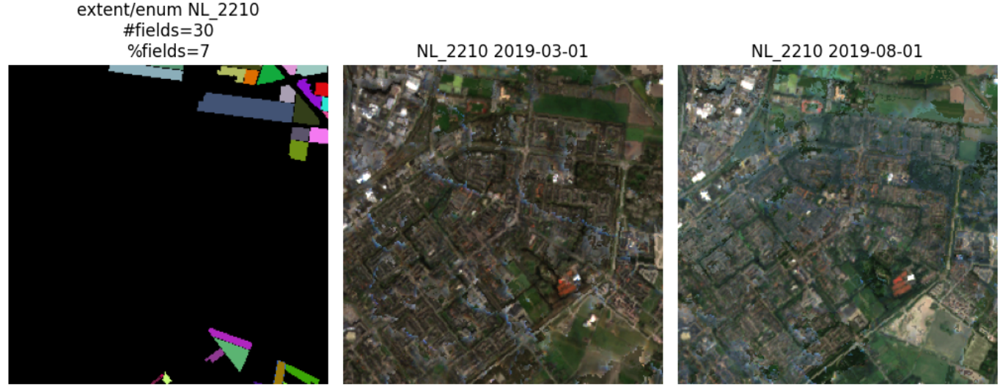